# 1. Pictures with Artist Thumnail MoMa

In [1]:
# Libraries
import pandas as pd
import seaborn as sns
import numpy as np
import os
import matplotlib.pyplot as plt
import requests
import urllib
import csv

In [2]:
df=pd.read_csv("moma.csv")

In [3]:
non_numeric=['Title','Artist','ConstituentID','ArtistBio','Nationality','BeginDate','EndDate','Gender','Medium','Dimensions','CreditLine','AccessionNumber','Classification','Department','DateAcquired','Cataloged','ObjectID','URL','ThumbnailURL','Date']

In [5]:
moma_non_numeric=df.loc[:,non_numeric]

In [6]:
moma_numeric=df.drop(non_numeric,axis=1)

### 1.1 Function to print images from artist

In [7]:
# Function to print images from artist

def show_images(artistas):
    
    
    images = []
    num_im_art = []
    for Artist in artistas:
        urls = df[(df.Artist == Artist) & (pd.notnull(df.ThumbnailURL))]['ThumbnailURL']
        for url in urls:
            f = urllib.request.urlopen(url)
            a = plt.imread(f,0)
            images.append(a)
        num_im_art.append(len(urls))
        
    
    before = 0
    for j in range(0, len(artistas)):
        fig = plt.figure()
        fig.subplots_adjust(left=0, right=5, bottom=0, top=1, hspace=0.05, wspace=0.05)
        if (j==0):
            for i in range(0, num_im_art[j]):
                ax = fig.add_subplot(1, num_im_art[j], i + 1, xticks=[], yticks=[])
                ax.imshow(images[i], cmap=plt.cm.binary, interpolation='nearest')
        else:
            for i in range(0, num_im_art[j]):
                ax = fig.add_subplot(1, num_im_art[j], i + 1, xticks=[], yticks=[])
                ax.imshow(images[before+i], cmap=plt.cm.binary, interpolation='nearest')
        before = before + num_im_art[j]
        plt.show()

In [8]:
df.Artist.unique()

array(['Otto Wagner', 'Christian de Portzamparc', 'Emil Hoppe', ...,
       'Ruby Sky Stiler', 'Sachiko Kazama',
       'The Event Horizon Telescope Collaboration'], dtype=object)

In [9]:
artistas = ['Christian de Portzamparc', 'Sachiko Kazama', 'Ruby Sky Stiler']

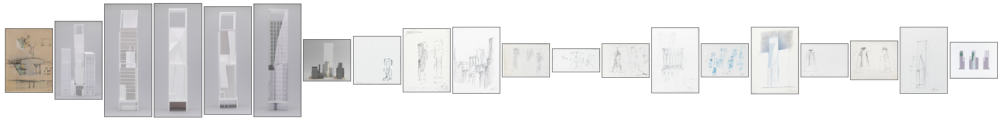

<Figure size 432x288 with 0 Axes>

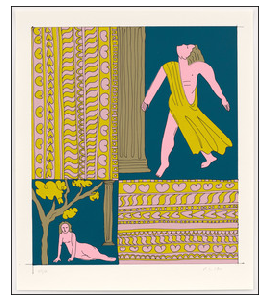

In [10]:
show_images(artistas)

# 2. Principal Component Analysis of a dataset of Artwork

The data comes from Kaggle Art Images: https://www.kaggle.com/thedownhill/art-images-drawings-painting-sculpture-engraving . This dataset has 5 types of art:



1.Drawings and watercolours 


2.Works of painting


3.Sculpture


4.Engraving


5.Iconography (old Russian art)

Because this dataset has 9 thousand images, we are going to use only 168, of the classes drawing, painting, iconography and engraving. We select the images randomly.

In [119]:
from keras.preprocessing.image import ImageDataGenerator
import PIL
import os, sys 
import numpy as np
import cv2 # OpenCV-Python
%matplotlib inline
import matplotlib.pyplot as plt
from skimage import io
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA,FastICA
from matplotlib.ticker import PercentFormatter
from mpl_toolkits.mplot3d import Axes3D 
from scipy.cluster.vq import kmeans, vq
from matplotlib.lines import Line2D
import random

In [120]:
# Initialize seed so all results can be reproducible
random.seed(25)

### 2.1 Delete bad Images

The dataset has some bad images that can not be read. We are going to delete those images. 

In [2]:
def is_corrupted(img_file):
''' Tell if an image is corrupted or not'''
    try:
        img = io.imread(img_file)
    except:
        return True
    return False

In [ ]:
# Check each image and if one is corrupted, we save the path.

images_corrupted = []

for dir_name_main in DIRECTORIOS_MAIN:
    for dir_name_image in DIRECTORIOS_IMAGES:
        path_new = PATH + "/" + dir_name_main + "/" + dir_name_image
        for filename in os.listdir(path_new):
            origen = path_new + "/" + filename
            if (is_corrupted(origen)):
                images_corrupted.append(origen)

In [99]:
# Delete the corrupts images
for image_corrupted in images_corrupted:
    os.remove(image_corrupted)

### 2.2 Rename the images

Because we want to have a unique format for each image, we are going to rename them with their category 

In [100]:
for dir_name_main in DIRECTORIOS_MAIN:
    for dir_name_image in DIRECTORIOS_IMAGES:
        i = 1
        path_new = PATH + "//" + dir_name_main + "//" + dir_name_image
        for filename in os.listdir(path_new):
            origen = path_new + "//" + filename
            destino = path_new + "//" + dir_name_image + "-" + str(i) + ".jpg"
            os.rename(origen, destino)
            i = i + 1

## 3. Create a dataframe of the images

In [121]:
# Create a data generator
datagen = ImageDataGenerator()

#Iterator for each folder to obtain images
data_generator = datagen.flow_from_directory('C:/Users/raulf/DataScience/Visualizacion/Punto Extra/obras_arte', class_mode='categorical')

Found 200 images belonging to 4 classes.


In [122]:
#Confirm the iterator works
batchX, batchy = data_generator.next()
print('Batch shape=%s, min=%.3f, max=%.3f' % (batchX.shape, batchX.min(), batchX.max()))

Batch shape=(32, 256, 256, 3), min=0.000, max=255.000


### 3.1 Upload the images to the DataFrame

We are going to uppload each image to a pandas DF, having 200 rows and 196608 columns (Each row is an image and each column a pixel)

In [123]:
X = pd.DataFrame()
y = pd.DataFrame()
batch_index = 0

while batch_index <= data_generator.batch_index:
    data = data_generator.next()

    # Obtain the pixels

    data_X = data[0].reshape(data[0].shape[0],-1) #Reshape the numpy array so every image is a row and the 196608 columns the pixels (Each column a pixel)
    data_X = pd.DataFrame(data_X)
    X = X.append(data_X)
    
    # Obtain the images category
    
    data_y = data[1]
    data_y = pd.DataFrame(data_y)
    y = y.append(data_y)

    batch_index = batch_index + 1 #Incremental

#Change dummy variables to categories

y.columns = ['drawings', 'engraving', 'iconography', 'painting']
y = y.stack()
y = pd.DataFrame(y)
y.columns = ['binario']
y = y[ y['binario'] > 0 ]
y = y.reset_index()
y = pd.DataFrame(y['level_1'])
y = y.rename(columns={"level_1": "Category"})

#Combine the two DataFrames
X['Category']  =y

## 4. Principal Component Analysis and Independent Component Analysis

We are going to reduce the dimensionality by PCA and ICA.

In [16]:
random.seed(25)

In [17]:
# Create the scaler
scaler = StandardScaler()
X_std = scaler.fit_transform(X) # This step is not necesary because our values go from 0 to 255

# Create the PCA instance and fit and transform the data with pca
pca = PCA()
pc = pca.fit_transform(X_std)
pc = pd.DataFrame(pc)

In [18]:
# Create the DataFrame to do PCA 

pc_clustering = pc # This variable is created so we can obtain the principal components when we do the kmeans.
pc = pc.iloc[:, 0:3]
pc.columns = ['PCA 1', 'PCA 2', 'PCA 3']
pc['Categories'] = y

C:\Users\raulf\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [19]:
# Create the ICA and perform
ica = FastICA()
ic = ica.fit_transform(X_std)
ic = pd.DataFrame(ic)

C:\Users\raulf\Anaconda3\lib\site-packages\sklearn\decomposition\fastica_.py:119: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  ConvergenceWarning)


In [20]:
#DataFrame to perform ICA
ic_clustering = ic
ic = ic.iloc[:, 0:3]
ic.columns = ['ICA 1', 'ICA 2', 'ICA 3']
ic['Categories'] = y

C:\Users\raulf\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


## 5. Understanding PCA 

We are going to create a Pareto Chart to understand the variation that captures the PCA

In [21]:
random.seed(25)

In [22]:
# Change the Jupyter parameters so the graphs are bigger
plt.rcParams['figure.figsize'] = (17,6)

In [23]:
pca_list = [str(x+1) for x in range(200)] # Labels PCA1, PCA2 etc.
pca_list = pd.DataFrame(pca_list)
pareto = pd.DataFrame(pca.explained_variance_ratio_.cumsum(), pca.explained_variance_ratio_)
pareto = pareto.reset_index()
pareto['Principal_Components'] = pca_list
pareto.set_index('Principal_Components', inplace=True)
pareto.columns=['Explained_Variance', 'Explained_Variance_Cumulative']

In [24]:
# Filter to obatin only 80% of variation
pareto = pareto[pareto['Explained_Variance_Cumulative']<0.80]

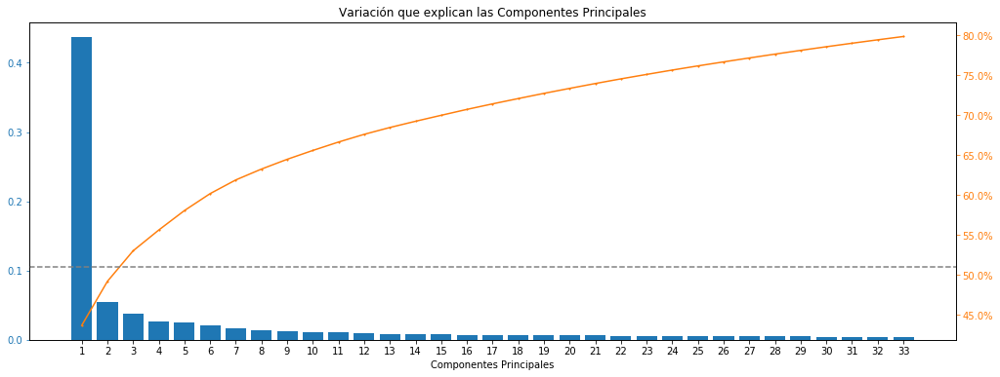

In [25]:
# Plot Pareto Chart
fig, ax = plt.subplots()
ax.bar(pareto.index, pareto["Explained_Variance"], color="C0")
ax2 = ax.twinx()



ax2.plot(pareto.index, pareto["Explained_Variance_Cumulative"]*100, color="C1", marker="D", ms=1)
ax2.yaxis.set_major_formatter(PercentFormatter())

plt.axhline(y=51, color='gray', linestyle='--')

plt.title('Variación que explican las Componentes Principales')

ax.tick_params(axis="y", colors="C0")
ax2.tick_params(axis="y", colors="C1")
ax.set_xlabel('Componentes Principales')
plt.show()

With this Pareto Chart we can see that we can capture 80% of the variation with only 35 principal components. However, we can see that after the sixth component the others ones represents a small variation.

With only 3 components, we can explain 51% of variation.

## 6. Kmeans Clustering

We choose Kmeans, because it has an optimal processing time and uses not many resources.

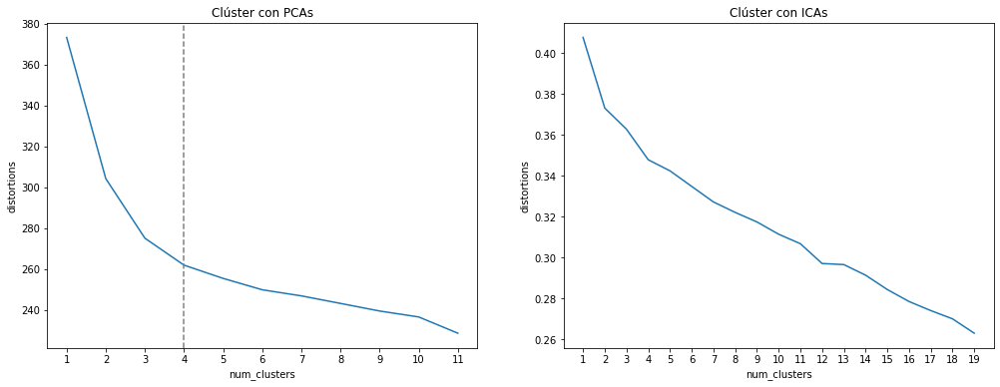

In [26]:
########################################################################################################################
#####################  Kmeans with Principal Component Analysis ########################################################
########################################################################################################################
random.seed(25)
distortions = []
num_clusters = range(1, 12)

# Create a list of distortions from the kmeans function (CON PCA)
for i in num_clusters:
    cluster_centers, distortion = kmeans(pc_clustering.iloc[:,0:35], i) #Se meten 35 componentes principales porque representa el 85% de la variación
    distortions.append(distortion)

# Create a data frame with two lists - num_clusters, distortions
elbow_plot = pd.DataFrame({'num_clusters': num_clusters, 'distortions': distortions})

# Create a line plot of num_clusters and distortions
plt.subplot(1,2,1)
plt.title('Clúster con PCAs')
sns.lineplot(x='num_clusters', y='distortions', data = elbow_plot)
plt.axvline(x=4,color='gray',linestyle='--')
plt.xticks(num_clusters)

########################################################################################################################
##################### Kmeans with Independent Component Analysis #######################################################
########################################################################################################################

distortions = []
num_clusters = range(1, 20)

# Create a list of distortions from the kmeans function (CON PCA)
for i in num_clusters:
    cluster_centers, distortion = kmeans(ic_clustering.iloc[:,0:35], i) #Se meten 35 componentes principales para que compita en igualdad con PCA
    distortions.append(distortion)

# Create a data frame with two lists - num_clusters, distortions
elbow_plot = pd.DataFrame({'num_clusters': num_clusters, 'distortions': distortions})

#Variables for the annotate function

# Create a line plot of num_clusters and distortions
plt.subplot(1,2,2)
plt.title('Clúster con ICAs')
sns.lineplot(x='num_clusters', y='distortions', data = elbow_plot)
plt.xticks(num_clusters) 
plt.show()

With PCAs we see a drastic decrease of distortion between 1 and 4 clusters. This makes sense, because we are grouping the four categories of paintings that we had. With ICA the decrease of distortion is in a lineal form, with different slopes through the graph.

For these reasons, we are going to do the clusterization with PCAs and with 4 clusters. 

In [27]:
random.seed(25)
# Execute kmeans with 4 clusters
cluster_centers, distortion = kmeans(pc_clustering.iloc[:,0:35], 4)
# Assign cluster labels
pc['cluster_labels'], _ = vq(pc_clustering.iloc[:,0:35], cluster_centers)

C:\Users\raulf\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [28]:
pc['cluster_labels']=pc['cluster_labels'].astype('str')
pc['cluster_labels']='Cluster_'+pc['cluster_labels']

C:\Users\raulf\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\raulf\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


## 7. Plot 3d

### 7.1 Principal Components PCA

In [29]:
# Change Jupyter parameters so graph is bigger
plt.rcParams['figure.figsize']=(17,6)

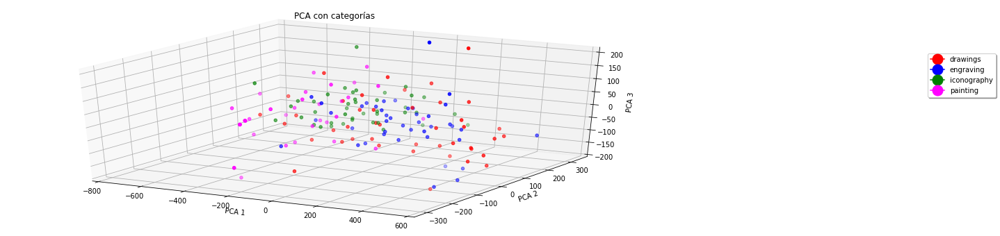

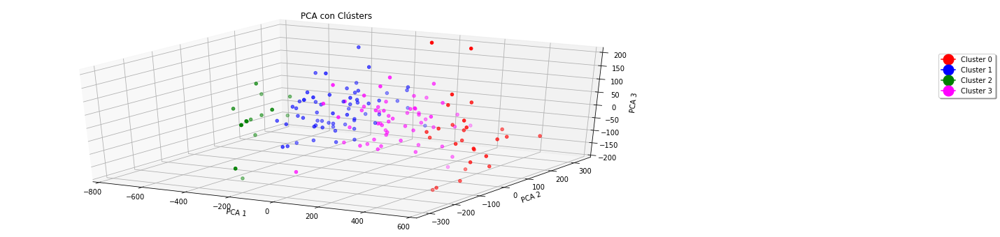

In [30]:

#############################################################################################
##################### Graph PCA #############################################################
#############################################################################################

random.seed(25)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

colors = {'drawings':'red', 'engraving':'blue', 'iconography':'green', 'painting':'magenta'}

ax.scatter(pc['PCA 1'], pc['PCA 2'], pc['PCA 3'], c=pc['Categories'].apply(lambda x: colors[x]), marker='o')

ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')

ax.set_xlim(-800,600)
ax.set_zlim(-200,210)

# Add legends

legend_elements = [Line2D([0], [0], marker='o', color='r', label='drawings',markerfacecolor='red', markersize=15),
                   Line2D([0], [0], marker='o', color='blue', label='engraving',markerfacecolor='blue', markersize=15),
                   Line2D([0], [0], marker='o', color='green', label='iconography',markerfacecolor='green', markersize=15),
                   Line2D([0], [0], marker='o', color='magenta', label='painting',markerfacecolor='magenta', markersize=15)                                      
                  ]

ax.legend(handles=legend_elements,loc='upper center', bbox_to_anchor=(1.45, 0.8), shadow=True, ncol=1)


plt.title('PCA con categorías')

#################################################################################################
##################### Graph Cluster ###########################################################
#################################################################################################
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

colors = {'Cluster_0':'red', 'Cluster_1':'blue', 'Cluster_2':'green', 'Cluster_3':'magenta'}

ax.scatter(pc['PCA 1'], pc['PCA 2'], pc['PCA 3'], c=pc['cluster_labels'].apply(lambda x: colors[x]), marker='o')

ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')

ax.set_xlim(-800,600)
ax.set_zlim(-200,210)

#Codigo para poner las leyendas

legend_elements = [Line2D([0], [0], marker='o', color='r', label='Cluster 0',markerfacecolor='red', markersize=15),
                   Line2D([0], [0], marker='o', color='blue', label='Cluster 1',markerfacecolor='blue', markersize=15),
                   Line2D([0], [0], marker='o', color='green', label='Cluster 2',markerfacecolor='green', markersize=15),
                   Line2D([0], [0], marker='o', color='magenta', label='Cluster 3',markerfacecolor='magenta', markersize=15)                                      
                  ]

ax.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(1.45, 0.8), shadow=True, ncol=1)

plt.title('PCA con Clústers')

 
plt.show()

In the two graphs we can say that with PCA we can not distinguish the categories. Kmeans is not clustering based on the categories, but in his distance function. Later we are going to explore kmeans in depth.

### 7.2 Independent Component Analysis ICA

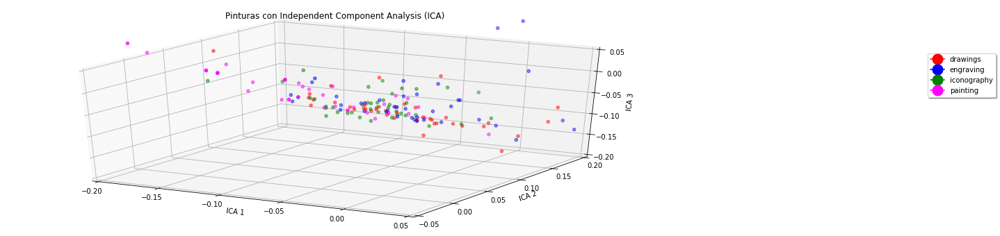

In [31]:
random.seed(25)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

colors = {'drawings':'red', 'engraving':'blue', 'iconography':'green', 'painting':'magenta'}

ax.scatter(ic['ICA 1'], ic['ICA 2'], ic['ICA 3'], c=ic['Categories'].apply(lambda x: colors[x]), marker='o')

legend_elements = [Line2D([0], [0], marker='o', color='r', label='drawings',markerfacecolor='red', markersize=15),
                   Line2D([0], [0], marker='o', color='blue', label='engraving',markerfacecolor='blue', markersize=15),
                   Line2D([0], [0], marker='o', color='green', label='iconography',markerfacecolor='green', markersize=15),
                   Line2D([0], [0], marker='o', color='magenta', label='painting',markerfacecolor='magenta', markersize=15)                                      
                  ]

ax.legend(handles=legend_elements,loc='upper center', bbox_to_anchor=(1.45, 0.8), shadow=True, ncol=1)

ax.set_xlabel('ICA 1')
ax.set_ylabel('ICA 2')
ax.set_zlabel('ICA 3')

ax.set_xlim(-0.2,0.05)
ax.set_ylim(-0.05,0.2)
ax.set_zlim(-0.2,0.05)


plt.title('Pinturas con Independent Component Analysis (ICA)')

plt.show()

With ICA we do not find differences between categories.

## 8. Understanding Clusterization

### 8.1 Distribution and Cluster Count

In [32]:
pc_barplot = pc.groupby(['Categories','cluster_labels'],as_index=False)['PCA 1'].count().rename(columns={'PCA 1':'Conteo'})

Text(0, 0.5, 'Imágenes')

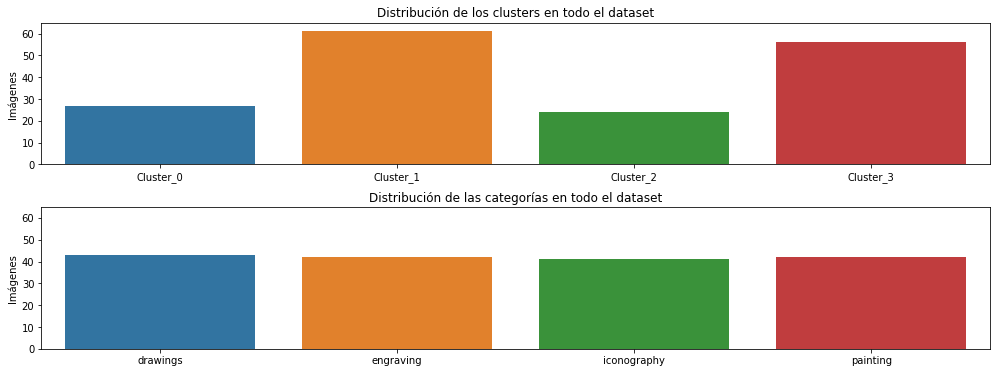

In [33]:
plt.subplots_adjust(hspace=0.3) #Add space between subplots 
plt.subplot(2,1,1)
sns.barplot(x='cluster_labels', y='Conteo', data=pc_barplot.groupby(['cluster_labels'], as_index=False)['Conteo'].sum(), order=["Cluster_0", "Cluster_1","Cluster_2","Cluster_3"])
plt.title('Distribución de los clusters en todo el dataset')
plt.xlabel("")
plt.ylim(0,65)
plt.ylabel("Imágenes")

plt.subplot(2,1,2)
sns.barplot(x='Categories', y='Conteo', data=pc_barplot.groupby(['Categories'], as_index=False)['Conteo'].sum())
plt.title('Distribución de las categorías en todo el dataset')
plt.ylim(0,65)
plt.xlabel("")
plt.ylabel("Imágenes")

The clusters are imbalanced, that is why they do not represent the categories. The categories are balanced.

Text(0.5, 1.0, 'Painting')

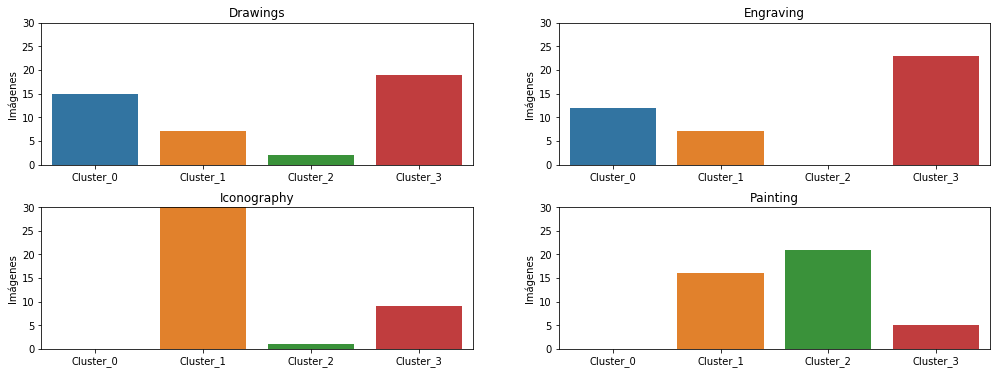

In [34]:
# This can be done with facet with less lines of code
plt.subplots_adjust(hspace=0.3) # Add space between subplots 

plt.subplot(2,2,1)
sns.barplot(x='cluster_labels', y='Conteo', data=pc_barplot[pc_barplot['Categories']=='drawings'], order=["Cluster_0", "Cluster_1","Cluster_2","Cluster_3"])
plt.xlabel('')
plt.ylim(0,30)
plt.ylabel('Imágenes')
plt.title('Drawings')

plt.subplot(2,2,2)
sns.barplot(x='cluster_labels', y='Conteo',data=pc_barplot[pc_barplot['Categories']=='engraving'], order=["Cluster_0", "Cluster_1","Cluster_2","Cluster_3"])
plt.xlabel('')
plt.ylim(0,30)
plt.ylabel('Imágenes')
plt.title('Engraving')

plt.subplot(2,2,3)
sns.barplot(x='cluster_labels', y='Conteo', data=pc_barplot[pc_barplot['Categories']=='iconography'], order=["Cluster_0", "Cluster_1","Cluster_2","Cluster_3"])
plt.xlabel('')
plt.ylim(0,30)
plt.ylabel('Imágenes')
plt.title('Iconography')

plt.subplot(2,2,4)
sns.barplot(x='cluster_labels', y='Conteo', data=pc_barplot[pc_barplot['Categories']=='painting'], order=["Cluster_0", "Cluster_1","Cluster_2","Cluster_3"])
plt.xlabel('')
plt.ylim(0,30)
plt.ylabel('Imágenes')
plt.title('Painting')


With this plots we can say that any cluster specializes in any category, with this we conclude the same as in the 3d gaph. However we can say that there are some clusters that specializes in some characteristics, because there are clusters where some categories do not appear.

## 9. Exploring the Artwork

### Different Clusters

Text(0.5, 1.0, 'Categoría:iconography,Cluster_1')

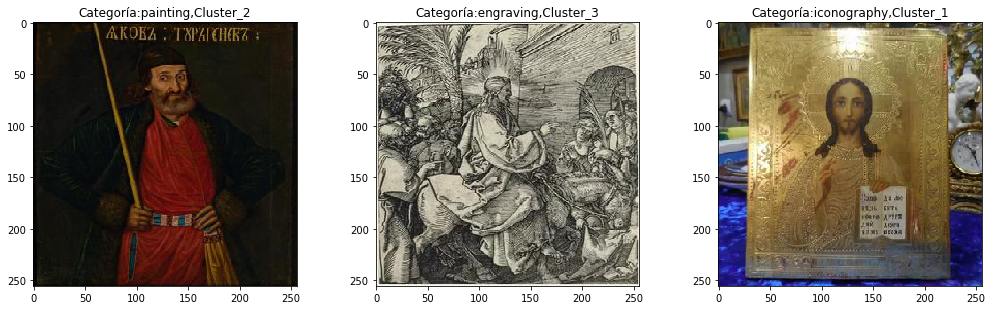

In [35]:
plt.subplots_adjust(wspace=0.3) # Add space between subplots 
plt.subplot(1,3,1)

indice = 0
# In X we have the images previously uploaded, every row is an image and every column a pixel.
# To plot we have to extract the row and format the numpyarray (256, 256, 3) 
imagen = X.iloc[indice,:].values.reshape(256,256,3) 

plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:"+str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

plt.subplot(1,3,2)

indice = 1
imagen = X.iloc[indice,:].values.reshape(256,256,3) 
plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:"+str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

plt.subplot(1,3,3)

indice = 47
imagen = X.iloc[indice,:].values.reshape(256,256,3) 
plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:"+str(y.iloc[indice,0])+","+str(pc.iloc[indice,4]))

### 9.2 Between Clusters 

Text(0.5, 1.0, 'Categoría:iconography,Cluster_1')

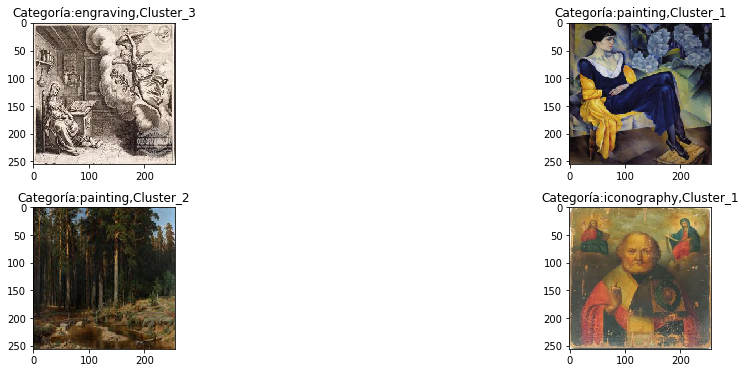

In [44]:
plt.subplots_adjust(wspace=0.3, hspace=0.3) # Add space between subplots 
plt.subplot(2, 2, 1)

indice = 135
# In X we have the images previously uploaded, every row is an image and every column a pixel.
# To plot we have to extract the row and format the numpyarray (256, 256, 3) 
imagen = X.iloc[indice,:].values.reshape(256,256,3) 

plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:" + str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

plt.subplot(2, 2, 2)

indice = 66
imagen = X.iloc[indice,:].values.reshape(256,256,3) 
plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:" + str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

plt.subplot(2, 2, 3)

indice = 56
imagen = X.iloc[indice,:].values.reshape(256,256,3) 
plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:" + str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

plt.subplot(2, 2, 4)

indice = 98
imagen = X.iloc[indice,:].values.reshape(256,256,3) 
plt.imshow((imagen).astype(np.uint8))
plt.title("Categoría:"+str(y.iloc[indice,0]) + "," + str(pc.iloc[indice,4]))

Observing the images between clusters and the classification of cluster 0. The clusters are not taking forms, figures, etc for make the cluster. However is interesting the type of colors that is taking to plot, so I am going to make the color histograms RGB to see if it is taking the colors as a clustering characteristic.

### 9.3 Histograms of the Distribution of Color

In [124]:
# Create Dataframe to check colors in Cluster 0

colors_df = pd.DataFrame()
indices = np.linspace(0, 167, 168, dtype=int) # Chose indexes of images to compare
for indice in indices:
    imagen = X.iloc[indice,:].values.reshape(256, 256, 3) 
    red = imagen[:, :, 0]
    green = imagen[:, :, 1]
    blue = imagen[:, :, 2]
    intermedio_df = pd.DataFrame({'red':red.ravel(), 'green':green.ravel(), 'blue':blue.ravel()})
    intermedio_df['Imagen'] = str(indice)
    intermedio_df['Categoria'] = str(y.iloc[indice,0])
    intermedio_df['Cluster'] = str(pc.iloc[indice,4])
    colors_df = colors_df.append(intermedio_df)

#Convert to tidy data
colors_df = pd.melt(colors_df, id_vars=['Imagen','Categoria','Cluster'], value_vars=['red','green','blue'])
colors_df.rename(columns={'variable':'Color'}, inplace=True)

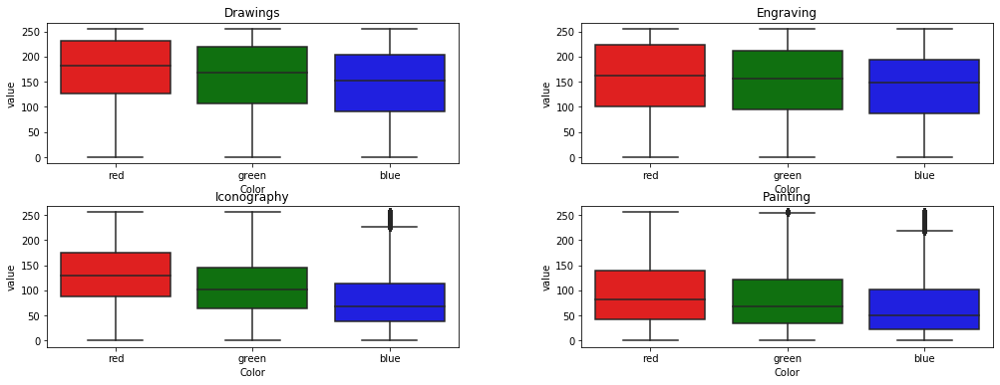

In [43]:
plt.subplots_adjust(wspace=0.3, hspace=0.3) # Add space between subplots 
my_pal = {"red": "r", "blue": "b", "green":"green"}

plt.subplot(2,2,1)

#ax=sns.violinplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='drawings'], palette=my_pal)
sns.boxplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='drawings'], palette=my_pal)
#ax = sns.swarmplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='drawings'], color="grey")
plt.title('Drawings')
plt.savefig('Drawings.jpg')

plt.subplot(2,2,2)

#ax=sns.violinplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='engraving'])
sns.boxplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='engraving'], palette=my_pal)
#ax = sns.swarmplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='engraving'], color="grey")
plt.title('Engraving')
plt.savefig('Engraving.jpg')

plt.subplot(2,2,3)
#ax=sns.violinplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='iconography'])
sns.boxplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='iconography'], palette=my_pal)
#ax = sns.swarmplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='iconography'], color="grey")
plt.title('Iconography')
plt.savefig('Iconography.jpg')

plt.subplot(2,2,4)
#ax=sns.violinplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='painting'])
sns.boxplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='painting'], palette=my_pal)
#ax = sns.swarmplot(x='Color', y='value', data=colors_df[colors_df['Categoria']=='painting'], color="grey")
plt.title('Painting')
plt.savefig('Painting.jpg')

To obtain this graphs we use a lot of computational resources, because the df colors_df has 33 millions of rows. 

We can obseve that the categories have different colors distribution. For example: Painting has the majority of values between 50 and 1500, while the other categories are between 100 and 220.

In [125]:
# Get representative images
# cluster=[cluster2 im0,cluster_1 im 3,cluster_0 im 13, cluter_3 im1]

colors_reduce = colors_df
colors_reduce.Imagen = pd.to_numeric(colors_reduce.Imagen)
# lista_imagenes=[0,1,3,13]
# filtro_imagenes=colors_reduce.Imagen.isin(filtro_imagenes)


colors_reduce = colors_reduce[colors_reduce['Imagen'] < 14]

colors_reduce = colors_reduce.loc[:, ['Cluster','Color','value']] #Get the df

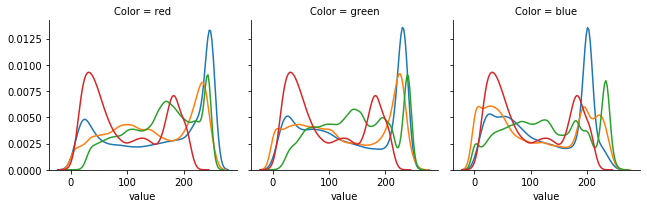

In [126]:
g = sns.FacetGrid(colors_reduce, col='Color', hue="Cluster")
g = (g.map(sns.distplot, "value", hist=False, rug=False))

In this graph every line represent a cluster. We can observe differences in the distribtuion of colors between clusters. That is why we can say that the important factor to cluster are the colors.